In [1]:
%cd ../..

C:\Users\ManuJoseph\OneDrive - Thoucentric\Work\Projects\Playground\AdvancedTimeSeriesForecastingBook\Github\Modern-Time-Series-Forecasting-with-Python-


In [2]:
import numpy as np
import gradio as gr
import matplotlib.pyplot as plt
import plotly.express as px
import os
import plotly.io as pio
pio.templates.default = "plotly_white"
import pandas as pd
from pathlib import Path
from tqdm.autonotebook import tqdm
from IPython.display import display, HTML
# %load_ext autoreload
# %autoreload 2
np.random.seed()
tqdm.pandas()

C:\Users\MANUJO~1\AppData\Local\Temp/ipykernel_22436/3931367617.py:9: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


In [3]:
os.makedirs("imgs/chapter_3", exist_ok=True)
preprocessed = Path("data/london_smart_meters/preprocessed")
assert preprocessed.is_dir(), "You have to run 02 - Preprocessing London Smart Meter Dataset.ipynb in Chapter02 before running this notebook"

In [12]:
from src.utils import plotting_utils
def format_plot(fig, legends = None, xlabel="Time", ylabel="Value", figsize=(500,900), font_size=15, title_font_size=20):
    if legends:
        names = cycle(legends)
        fig.for_each_trace(lambda t:  t.update(name = next(names)))
    fig.update_layout(
            autosize=False,
            width=figsize[1],
            height=figsize[0],
            title={
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top'},
            titlefont={
                "size": 20
            },
            legend_title = None,
            legend=dict(
                font=dict(size=font_size),
                orientation="h",
                yanchor="bottom",
                y=0.98,
                xanchor="right",
                x=1,
            ),
            yaxis=dict(
                title_text=ylabel,
                titlefont=dict(size=font_size),
                tickfont=dict(size=font_size),
            ),
            xaxis=dict(
                title_text=xlabel,
                titlefont=dict(size=font_size),
                tickfont=dict(size=font_size),
            )
        )
    return fig



# Reading Blocks 0-7

In [13]:
from src.utils.data_utils import compact_to_expanded

In [6]:
try:
    block_df = pd.read_parquet(preprocessed/"london_smart_meters_merged_block_0-7.parquet")
    display(block_df.head())
except FileNotFoundError:
    display(HTML("""
    <div class="alert alert-block alert-warning">
    <b>Warning!</b> File not found. Please make sure you have run 02 - Preprocessing London Smart Meter Dataset.ipynb in Chapter02
    </div>
    """))

,LCLid,start_timestamp,frequency,energy_consumption,series_length,stdorToU,Acorn,Acorn_grouped,file,holidays,...,windBearing,temperature,dewPoint,pressure,apparentTemperature,windSpeed,precipType,icon,humidity,summary
0,MAC000002,2012-10-13,30min,"[0.263, 0.2689999999999999, 0.275, 0.256, 0.21...",24144,Std,ACORN-A,Affluent,block_0,"[NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDA...",...,"[186, 186, 188, 188, 190, 190, 203, 203, 206, ...","[8.78, 8.78, 8.27, 8.27, 7.87, 7.87, 7.89, 7.8...","[6.28, 6.28, 6.21, 6.21, 6.22, 6.22, 6.76, 6.7...","[1007.7, 1007.7, 1007.36, 1007.36, 1006.73, 10...","[7.55, 7.55, 7.34, 7.34, 6.75, 6.75, 6.89, 6.8...","[2.28, 2.28, 1.81, 1.81, 1.95, 1.95, 1.83, 1.8...","[rain, rain, rain, rain, rain, rain, rain, rai...","[clear-night, clear-night, clear-night, clear-...","[0.84, 0.84, 0.87, 0.87, 0.89, 0.89, 0.93, 0.9...","[Clear, Clear, Clear, Clear, Partly Cloudy, Pa..."
1,MAC000246,2012-01-01,30min,"[0.509, 0.317, 0.253, 0.249, 0.93, 0.607, 0.10...",37872,Std,ACORN-A,Affluent,block_0,"[NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDA...",...,"[229, 229, 238, 238, 229, 229, 231, 231, 227, ...","[12.12, 12.12, 12.59, 12.59, 12.45, 12.45, 12....","[10.97, 10.97, 11.02, 11.02, 11.04, 11.04, 10....","[1008.1, 1008.1, 1007.88, 1007.88, 1007.95, 10...","[12.12, 12.12, 12.59, 12.59, 12.45, 12.45, 12....","[5.9, 5.9, 6.06, 6.06, 5.31, 5.31, 4.68, 4.68,...","[rain, rain, rain, rain, rain, rain, rain, rai...","[partly-cloudy-night, partly-cloudy-night, clo...","[0.93, 0.93, 0.9, 0.9, 0.91, 0.91, 0.93, 0.93,...","[Mostly Cloudy, Mostly Cloudy, Overcast, Overc..."
2,MAC000450,2012-03-23,30min,"[1.337, 1.426, 0.996, 0.971, 0.994, 0.952, 0.8...",33936,Std,ACORN-A,Affluent,block_0,"[NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDA...",...,"[78, 78, 73, 73, 81, 81, 80, 80, 75, 75, 71, 7...","[8.76, 8.76, 8.54, 8.54, 8.09, 8.09, 7.34, 7.3...","[7.25, 7.25, 7.12, 7.12, 7.17, 7.17, 6.68, 6.6...","[1027.41, 1027.41, 1026.91, 1026.91, 1026.54, ...","[7.59, 7.59, 7.43, 7.43, 7.24, 7.24, 7.34, 7.3...","[2.18, 2.18, 2.07, 2.07, 1.72, 1.72, 1.34, 1.3...","[rain, rain, rain, rain, rain, rain, rain, rai...","[fog, fog, fog, fog, fog, fog, fog, fog, fog, ...","[0.9, 0.9, 0.91, 0.91, 0.94, 0.94, 0.96, 0.96,...","[Foggy, Foggy, Foggy, Foggy, Foggy, Foggy, Fog..."
3,MAC001074,2012-05-09,30min,"[0.18, 0.086, 0.106, 0.173, 0.146, 0.223, 0.21...",31680,ToU,ACORN-,ACORN-,block_0,"[NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDA...",...,"[215, 215, 207, 207, 215, 215, 216, 216, 126, ...","[11.46, 11.46, 11.38, 11.38, 11.38, 11.38, 10....","[10.23, 10.23, 10.17, 10.17, 10.24, 10.24, 10....","[1007.39, 1007.39, 1007.21, 1007.21, 1007.06, ...","[11.46, 11.46, 11.38, 11.38, 11.38, 11.38, 10....","[2.35, 2.35, 2.15, 2.15, 1.84, 1.84, 1.22, 1.2...","[rain, rain, rain, rain, rain, rain, rain, rai...","[partly-cloudy-night, partly-cloudy-night, par...","[0.92, 0.92, 0.92, 0.92, 0.93, 0.93, 0.95, 0.9...","[Partly Cloudy, Partly Cloudy, Mostly Cloudy, ..."
4,MAC003223,2012-09-18,30min,"[0.076, 0.079, 0.123, 0.109, 0.051, 0.069, 0.0...",25344,Std,ACORN-A,Affluent,block_0,"[NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDAY, NO_HOLIDA...",...,"[236, 236, 240, 240, 242, 242, 244, 244, 248, ...","[14.06, 14.06, 13.12, 13.12, 12.53, 12.53, 12....","[10.82, 10.82, 10.29, 10.29, 9.86, 9.86, 9.83,...","[1011.09, 1011.09, 1010.82, 1010.82, 1010.65, ...","[14.06, 14.06, 13.12, 13.12, 12.53, 12.53, 12....","[3.86, 3.86, 3.81, 3.81, 4.27, 4.27, 4.12, 4.1...","[rain, rain, rain, rain, rain, rain, rain, rai...","[clear-night, clear-night, clear-night, clear-...","[0.81, 0.81, 0.83, 0.83, 0.84, 0.84, 0.86, 0.8...","[Clear, Clear, Clear, Clear, Clear, Clear, Par..."


Let's take all the consumers in one block for our exercise. Keep in mind, you can do the same with more number of blocks as long as it fits in your RAM

In [7]:
#Converting to expanded form
exp_block_df = compact_to_expanded(block_df[block_df.file=="block_7"], timeseries_col = 'energy_consumption',
static_cols = ["frequency", "series_length", "stdorToU", "Acorn", "Acorn_grouped", "file"],
time_varying_cols = ['holidays', 'visibility', 'windBearing', 'temperature', 'dewPoint',
       'pressure', 'apparentTemperature', 'windSpeed', 'precipType', 'icon',
       'humidity', 'summary'],
ts_identifier = "LCLid")

exp_block_df.head()

  0%|          | 0/50 [00:00<?, ?it/s]

,timestamp,LCLid,energy_consumption,frequency,series_length,stdorToU,Acorn,Acorn_grouped,file,holidays,...,windBearing,temperature,dewPoint,pressure,apparentTemperature,windSpeed,precipType,icon,humidity,summary
0,2012-01-01 00:00:00,MAC000050,0.175,30min,37872,Std,ACORN-D,Affluent,block_7,NO_HOLIDAY,...,229,12.12,10.97,1008.10,12.12,5.90,rain,partly-cloudy-night,0.93,Mostly Cloudy
1,2012-01-01 00:30:00,MAC000050,0.212,30min,37872,Std,ACORN-D,Affluent,block_7,NO_HOLIDAY,...,229,12.12,10.97,1008.10,12.12,5.90,rain,partly-cloudy-night,0.93,Mostly Cloudy
2,2012-01-01 01:00:00,MAC000050,0.313,30min,37872,Std,ACORN-D,Affluent,block_7,NO_HOLIDAY,...,238,12.59,11.02,1007.88,12.59,6.06,rain,cloudy,0.90,Overcast
3,2012-01-01 01:30:00,MAC000050,0.302,30min,37872,Std,ACORN-D,Affluent,block_7,NO_HOLIDAY,...,238,12.59,11.02,1007.88,12.59,6.06,rain,cloudy,0.90,Overcast
4,2012-01-01 02:00:00,MAC000050,0.257,30min,37872,Std,ACORN-D,Affluent,block_7,NO_HOLIDAY,...,229,12.45,11.04,1007.95,12.45,5.31,rain,partly-cloudy-night,0.91,Mostly Cloudy


In [8]:
# Taking a single time series from the block
ts_df = exp_block_df[exp_block_df.LCLid=="MAC000193"].set_index("timestamp")

In [9]:
ts_df["weekday_name"] = ts_df.index.day_name()
ts_df["weekday"] = ts_df.index.weekday
ts_df["week"] = ts_df.index.isocalendar().week
ts_df["day"] = ts_df.index.day
ts_df["hour"] = ts_df.index.hour
ts_df["date"] = ts_df.index.date
ts_df["month"] = ts_df.index.month
ts_df["month_name"] = ts_df.index.month_name()
ts_df["year"] = ts_df.index.year

In [10]:
#Making ordered categoricals to make for sorted plots
ts_df['month_name'] = pd.Categorical(ts_df['month_name'], categories=["January", "February", "March", "April", "May", "June", "July", "August", "September", "October", "November", "December"], ordered=True)
ts_df['weekday_name'] = pd.Categorical(ts_df['weekday_name'], categories=["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"], ordered=True)

In [11]:
#Interpolating Missing values
from src.imputation.interpolation import SeasonalInterpolation

ts_df['energy_consumption'] = SeasonalInterpolation(seasonal_period=48*7).fit_transform(ts_df.energy_consumption.values.reshape(-1,1))

# Line Charts

## Basic Line Plot

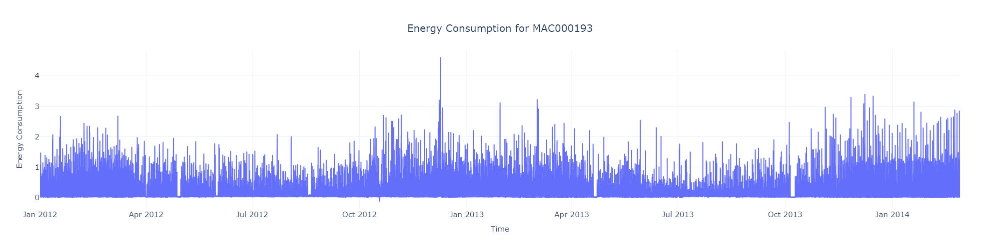

In [14]:
fig = px.line(ts_df, y="energy_consumption", title="Energy Consumption for MAC000193")
fig = format_plot(fig, ylabel="Energy Consumption")
fig.write_image("imgs/chapter_3/line_plot.png")
fig.show()

### Rolling Average Plot

In [15]:
ts_df["rolling_monthly_avg"] = ts_df["energy_consumption"].rolling(window=48*30).mean()

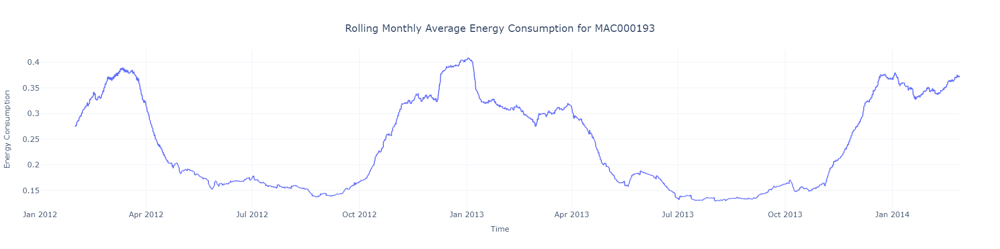

In [16]:
fig = px.line(ts_df, y="rolling_monthly_avg", title="Rolling Monthly Average Energy Consumption for MAC000193")
fig = format_plot(fig, ylabel="Energy Consumption")
fig.write_image("imgs/chapter_3/rolling_avg_line_plot.png")
fig.show()

## Multivariate Line Chart

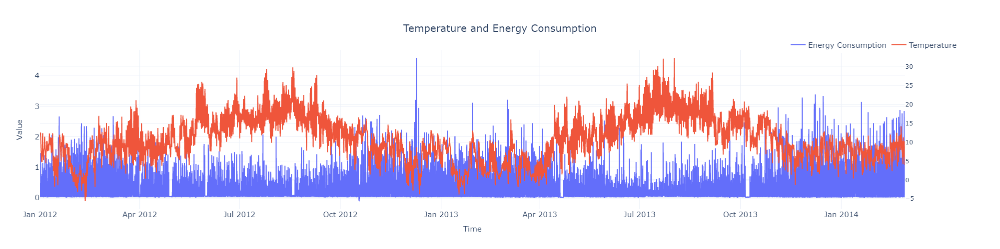

In [20]:
fig = plotting_utils.two_line_plot_secondary_axis(x=ts_df.index, 
                                   y1=ts_df.energy_consumption, 
                                   y2=ts_df.temperature, 
                                   y1_name="Energy Consumption", 
                                   y2_name="Temperature", 
                                   title="Temperature and Energy Consumption", 
                                   # greyscale=True,
                                  dash_secondary=False)
fig.update_layout(legend=dict(
                font=dict(size=15),
                orientation="h",
                yanchor="bottom",
                y=0.98,
                xanchor="right",
                x=1,
            ),
            yaxis=dict(
                # title_text=ylabel,
                titlefont=dict(size=15),
                tickfont=dict(size=15),
            ),
            xaxis=dict(
                # title_text=xlabel,
                titlefont=dict(size=15),
                tickfont=dict(size=15),
            ))
fig.write_image("imgs/chapter_3/temp_vs_energy.png")
fig.show()

### Multivariate Line Chart - Hourly Resolution

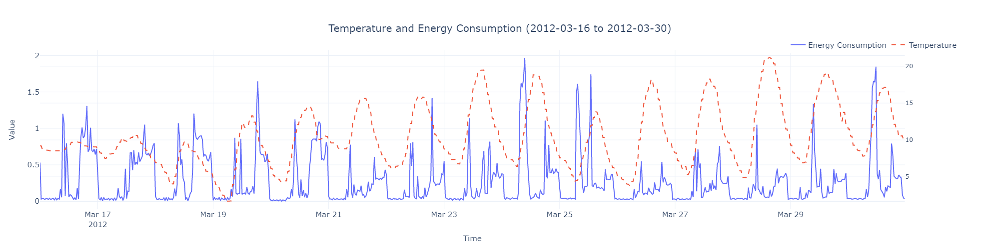

In [21]:
zoom_window = slice("2012-03-16", "2012-03-30")
fig = plotting_utils.two_line_plot_secondary_axis(x=ts_df[zoom_window].index, 
                                   y1=ts_df[zoom_window].energy_consumption, 
                                   y2=ts_df[zoom_window].temperature, 
                                   y1_name="Energy Consumption", 
                                   y2_name="Temperature", 
                                   title="Temperature and Energy Consumption (2012-03-16 to 2012-03-30)",
                                   greyscale=False,
                                   dash_secondary=True)
fig.update_layout(legend=dict(
                font=dict(size=15),
                orientation="h",
                yanchor="bottom",
                y=0.98,
                xanchor="right",
                x=1,
            ),
            yaxis=dict(
                # title_text=ylabel,
                titlefont=dict(size=15),
                tickfont=dict(size=15),
            ),
            xaxis=dict(
                # title_text=xlabel,
                titlefont=dict(size=15),
                tickfont=dict(size=15),
            ))
fig.write_image("imgs/chapter_3/temp_vs_energy_zoomed.png")
fig.show()

### Multivariate Line Chart - Monthly Resolution

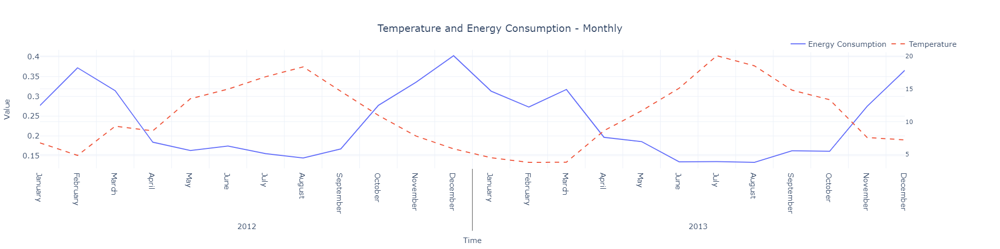

In [22]:
# Average energy_consumption and temperature for each month
plot_df = ts_df[~ts_df.year.isin([2011, 2014])].groupby(["year", "month_name"])[['energy_consumption', "temperature"]].mean().reset_index()
plot_df['year_month'] = plot_df["year"].astype(str) +" "+ plot_df['month_name'].astype(str).str.zfill(2)
fig = plotting_utils.two_line_plot_secondary_axis(x=[plot_df.year, plot_df.month_name], y1=plot_df.energy_consumption, y2=plot_df.temperature, y1_name="Energy Consumption", y2_name="Temperature", title="Temperature and Energy Consumption - Monthly", dash_secondary=True)
fig.update_layout(legend=dict(
                font=dict(size=15),
                orientation="h",
                yanchor="bottom",
                y=0.98,
                xanchor="right",
                x=1,
            ),
            yaxis=dict(
                # title_text=ylabel,
                titlefont=dict(size=15),
                tickfont=dict(size=15),
            ),
            xaxis=dict(
                # title_text=xlabel,
                titlefont=dict(size=15),
                tickfont=dict(size=15),
            ))
fig.write_image("imgs/chapter_3/temp_vs_energy_monthly.png")
fig.show()

# Seasonal Plots

## Annual Seasonality at Monthly Resolution

In [23]:
#Montlhly Average energy consumption
plot_df = ts_df[~ts_df.year.isin([2011, 2014])].groupby(["year", "month_name"])[['energy_consumption',"temperature"]].mean().reset_index()

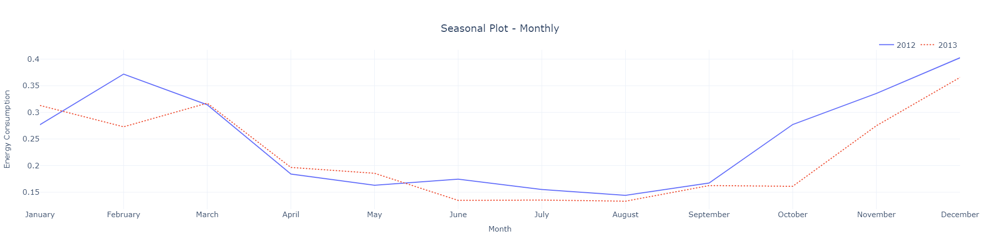

In [24]:
fig = px.line(plot_df, x="month_name", y='energy_consumption', color="year", line_dash="year", title="Seasonal Plot - Monthly")
fig = format_plot(fig, ylabel="Energy Consumption", xlabel="Month")
fig.update_layout(legend=dict(
                font=dict(size=15),
                orientation="h",
                yanchor="bottom",
                y=0.98,
                xanchor="right",
                x=1,
            ),
            yaxis=dict(
                # title_text=ylabel,
                titlefont=dict(size=15),
                tickfont=dict(size=15),
            ),
            xaxis=dict(
                # title_text=xlabel,
                titlefont=dict(size=15),
                tickfont=dict(size=15),
            ))
fig.write_image("imgs/chapter_3/seasonal_plot_monthly.png")
fig.show()

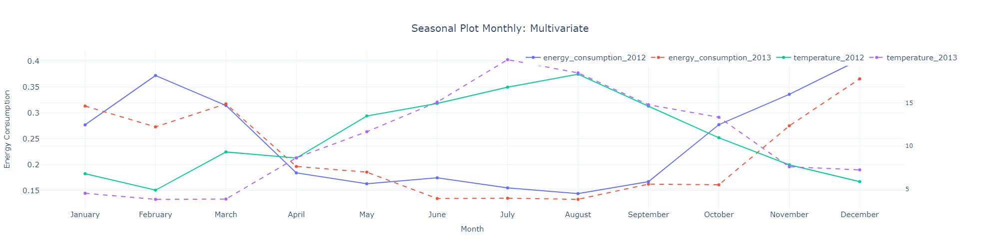

In [27]:
fig = plotting_utils.multiple_line_plot_secondary_axis(plot_df, 
                                        x="month_name", 
                                        primary='energy_consumption', 
                                        secondary='temperature', 
                                        color_or_linetype="year", 
                                        title="Seasonal Plot Monthly: Multivariate",
                                       use_linetype=True,
                                       greyscale=False)
fig = format_plot(fig, ylabel="Energy Consumption", xlabel="Month")
fig.update_layout(legend=dict(
                orientation="h",
                yanchor="bottom",
                y=0.9,
                xanchor="right",
                x=1,
            ))
fig.write_image("imgs/chapter_3/seasonal_plot_monthly_mv.png")
fig.show()

## Daily Seasonality at Hourly Resolution

In [29]:
#Calculating the day-hour average
plot_df = ts_df.groupby(["day", "hour"])['energy_consumption'].mean().reset_index()

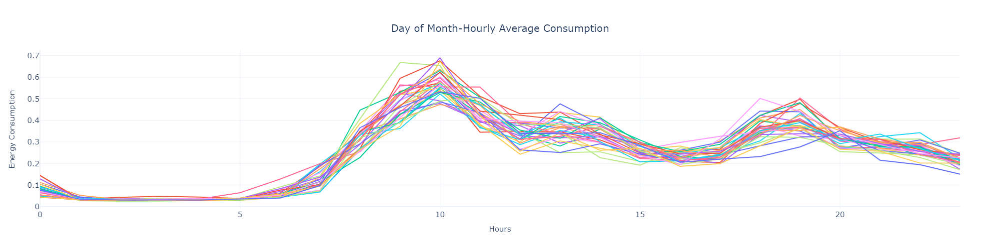

In [31]:
fig = px.line(plot_df[["energy_consumption", "hour", "day"]], y="energy_consumption", x="hour",color="day", title="Day of Month-Hourly Average Consumption")
fig = format_plot(fig, ylabel="Energy Consumption", xlabel="Hours", legends=None)
fig.update_layout(showlegend=False) 
# plotting_utils.make_lines_greyscale(fig)
fig.write_image("imgs/chapter_3/seasonal_plot_hourly.png")
fig.show()

# Seasonal Box Plots

In [38]:
plot_df =  ts_df.groupby(["date","weekday_name", "hour"])["energy_consumption"].mean().reset_index().dropna()

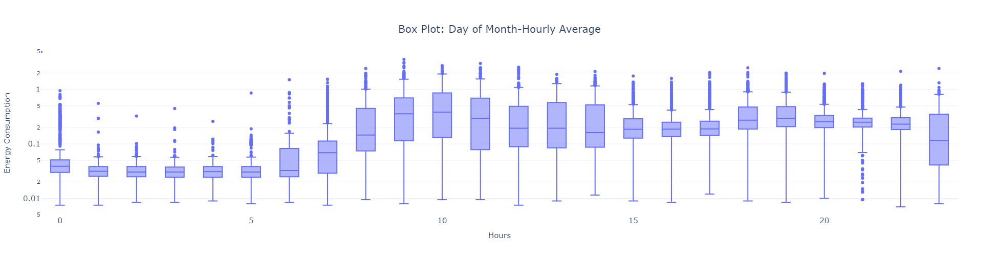

In [39]:
fig = px.box(plot_df, y="energy_consumption", x="hour", log_y=True, title="Box Plot: Day of Month-Hourly Average")
fig = format_plot(fig, ylabel="Energy Consumption", xlabel="Hours", legends=None)
fig.write_image("imgs/chapter_3/box_plot_hourly_avg.png")
fig.show()

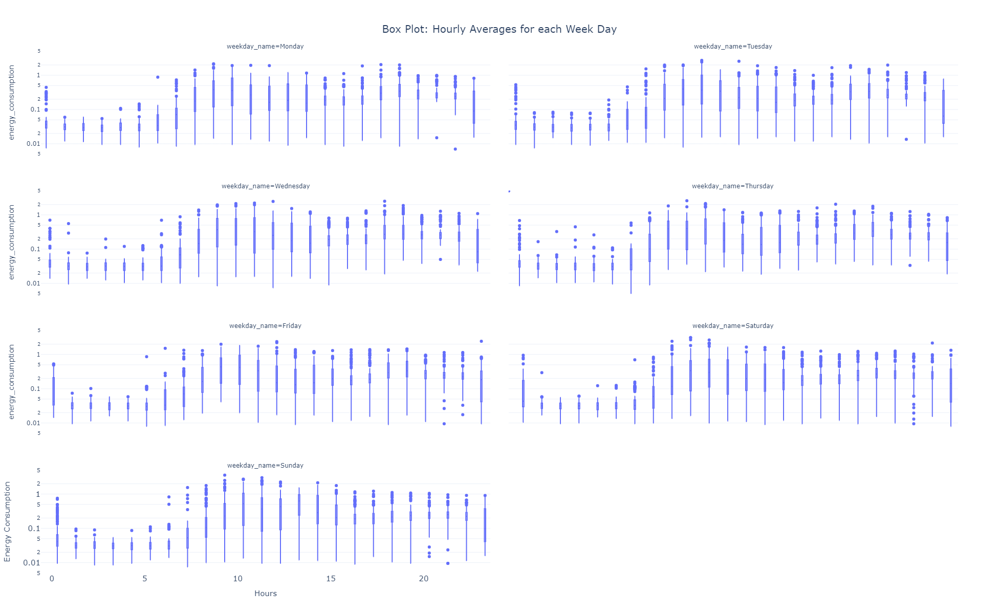

In [34]:
fig = px.box(plot_df, y="energy_consumption", x="hour", facet_col="weekday_name", facet_col_wrap=2, log_y=True, category_orders={"weekday_name":ts_df.weekday_name.cat.categories.tolist()}, title="Box Plot: Hourly Averages for each Week Day")
fig = format_plot(fig, ylabel="Energy Consumption", xlabel="Hours", legends=None, figsize=(1200, 1500))
fig.write_image("imgs/chapter_3/box_plot_hourly_weekday.png")
fig.show()

# Calendar Heatmap

In [40]:
plot_df = pd.pivot_table(ts_df, index="weekday_name", values='energy_consumption', columns="hour", aggfunc="mean")
# plot_df.index = "Day "+ plot_df.index.astype(str)

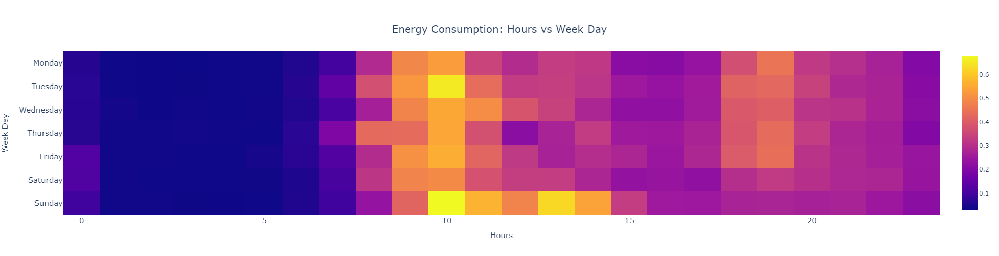

In [41]:
fig = px.imshow(plot_df, height=600, title="Energy Consumption: Hours vs Week Day")
fig = format_plot(fig, ylabel="Week Day", xlabel="Hours", legends=None)
fig.write_image("imgs/chapter_3/hour_weekday_heatmap.png")
fig.show()

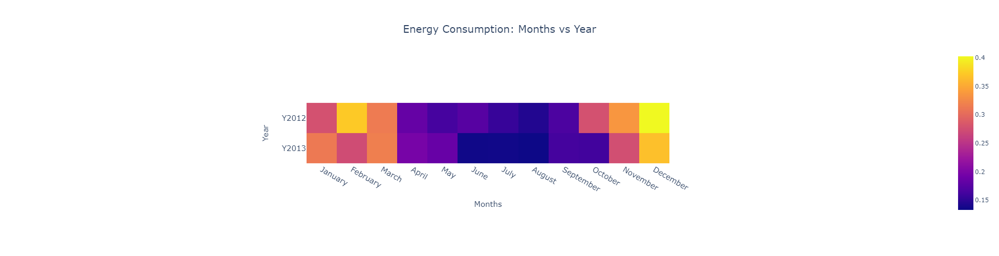

In [42]:
plot_df = pd.pivot_table(ts_df[~ts_df.year.isin([2011, 2014])], index="year", values='energy_consumption', columns="month_name", aggfunc="mean")
plot_df.index = "Y"+ plot_df.index.astype(str)

fig = px.imshow(plot_df, height=600, title="Energy Consumption: Months vs Year")
fig = format_plot(fig, ylabel="Year", xlabel="Months", legends=None)
fig.write_image("imgs/chapter_3/month_year_heatmap.png")
fig.show()

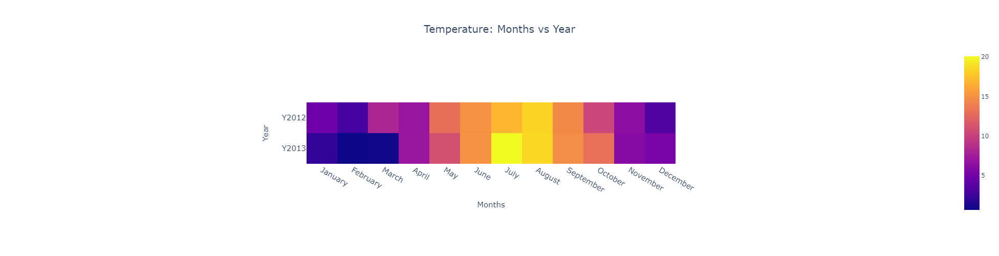

In [43]:
plot_df = pd.pivot_table(ts_df[~ts_df.year.isin([2011, 2014])], index="year", values='apparentTemperature', columns="month_name", aggfunc="mean")
plot_df.index = "Y"+ plot_df.index.astype(str)

fig = px.imshow(plot_df, height=600, title="Temperature: Months vs Year")
fig = format_plot(fig, ylabel="Year", xlabel="Months", legends=None)
fig.write_image("imgs/chapter_3/month_year_heatmap_temperature.png")
fig.show()

# Autocorrelation Plots

In [44]:
from src.decomposition.seasonal import MultiSeasonalDecomposition, STL
stl = MultiSeasonalDecomposition(seasonal_model="fourier",seasonality_periods=["day_of_year", "day_of_week", "hour"], model = "additive", n_fourier_terms=10)
res = stl.fit(ts_df.energy_consumption)

C:\Users\ManuJoseph\miniconda3\envs\modern_ts\lib\site-packages\sklearn\linear_model\_base.py:141: FutureWarning:

'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), _RidgeGCV())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)



C:\Users\ManuJoseph\miniconda3\envs\modern_ts\lib\site-packages\sklearn\linear_model\_base.py:141: FutureWarning:

'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import m

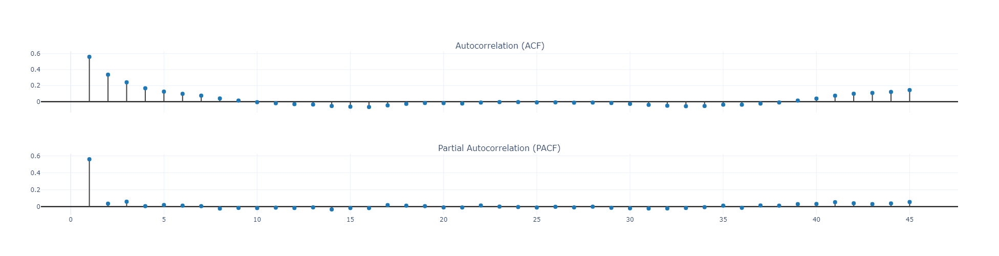

In [22]:
fig = plotting_utils.plot_autocorrelation(res.resid, vertical=True)
fig.write_image("imgs/chapter_3/acf_pacf.png")
fig.show()